## Competencia de clasificación



|Variable|Descripción|
|---|---|
|**LIMIT_BAL:**|Amount of given credit in NT dollars (includes individual and family/supplementary credit|
|**SEX:**|Gender (1=male, 2=female)|
|**EDUCATION:**|(1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)|
|**MARRIAGE:**|Marital status (1=married, 2=single, 3=others)|
|**AGE:**|Age in years|
|**PAY_0:**|Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, � 8=payment delay for eight months, 9=payment delay for nine months and above)|
|**PAY_2:**|Repayment status in August, 2005 (scale same as above)|
|**PAY_3:**|Repayment status in July, 2005 (scale same as above)|
|**PAY_4:**|Repayment status in June, 2005 (scale same as above)|
|**PAY_5:**|Repayment status in May, 2005 (scale same as above)|
|**PAY_6:**|Repayment status in April, 2005 (scale same as above)|
|**BILL_AMT1:**|Amount of bill statement in September, 2005 (NT dollar)|
|**BILL_AMT2:**|Amount of bill statement in August, 2005 (NT dollar)|
|**BILL_AMT3:**|Amount of bill statement in July, 2005 (NT dollar)|
|**BILL_AMT4:**|Amount of bill statement in June, 2005 (NT dollar)|
|**BILL_AMT5:**|Amount of bill statement in May, 2005 (NT dollar)|
|**BILL_AMT6:**|Amount of bill statement in April, 2005 (NT dollar)|
|**PAY_AMT1:**|Amount of previous payment in September, 2005 (NT dollar)|
|**PAY_AMT2:**|Amount of previous payment in August, 2005 (NT dollar)|
|**PAY_AMT3:**|Amount of previous payment in July, 2005 (NT dollar)|
|**PAY_AMT4:**|Amount of previous payment in June, 2005 (NT dollar)|
|**PAY_AMT5:**|Amount of previous payment in May, 2005 (NT dollar)|
|**PAY_AMT6:**|Amount of previous payment in April, 2005 (NT dollar)|
|**default.**|ayment.next.month: Default payment (1=yes, 0=no)|

In [192]:
import numpy as np
import pandas as pd
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.svm import SVC
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import mutual_info_regression
from sklearn.neural_network import MLPClassifier
from sklearn import preprocessing
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import StackingClassifier
from sklearn.metrics import confusion_matrix
from sklearn.utils import resample
import tensorflow as tf
from tensorflow import keras
import xgboost as xgb
from imblearn.over_sampling import SMOTE

path = './files/'

In [2]:
train = pd.read_excel('https://raw.githubusercontent.com/dayroncj/Uniandes/main/Train.xlsx')
test = pd.read_excel('https://raw.githubusercontent.com/dayroncj/Uniandes/main/Test.xlsx')

train: 23999 / test:6001

## 1. Exploración y Visualización de datos

In [3]:
train

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,240000,2,2,2,37,-2,-2,-2,-2,-2,...,0,0,0,0,0,0,0,0,0,0
1,240000,2,3,1,43,0,0,0,0,0,...,65130,66494,67441,2300,2400,2329,2411,2050,2000,0
2,40000,2,1,2,24,0,0,0,0,0,...,37263,35224,34111,5000,8017,7000,4000,5000,5000,1
3,360000,1,1,2,29,-2,-2,-2,-2,-2,...,3466,1630,2931,2358,3788,3483,1638,2946,16950,0
4,130000,1,1,2,27,0,0,0,0,0,...,35194,35951,36703,1867,1872,1256,1500,1500,1500,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23994,80000,2,2,2,26,1,-2,-2,-2,-2,...,0,0,0,0,0,0,0,0,0,0
23995,50000,2,3,2,28,1,3,3,2,2,...,40165,42683,43843,2500,0,0,3200,2000,1700,0
23996,500000,1,1,2,33,-1,-1,-1,-2,-1,...,4158,7958,-196,2065,10556,4170,7963,196,7083,0
23997,50000,1,2,2,42,2,2,2,2,-1,...,22402,9528,8447,0,3701,554,10026,421,6106,0


In [4]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23999 entries, 0 to 23998
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype
---  ------                      --------------  -----
 0   LIMIT_BAL                   23999 non-null  int64
 1   SEX                         23999 non-null  int64
 2   EDUCATION                   23999 non-null  int64
 3   MARRIAGE                    23999 non-null  int64
 4   AGE                         23999 non-null  int64
 5   PAY_0                       23999 non-null  int64
 6   PAY_2                       23999 non-null  int64
 7   PAY_3                       23999 non-null  int64
 8   PAY_4                       23999 non-null  int64
 9   PAY_5                       23999 non-null  int64
 10  PAY_6                       23999 non-null  int64
 11  BILL_AMT1                   23999 non-null  int64
 12  BILL_AMT2                   23999 non-null  int64
 13  BILL_AMT3                   23999 non-null  int64
 14  BILL_A

In [5]:
pd.DataFrame(train.isnull().sum()).sort_values(by=[0], ascending=False).T

,LIMIT_BAL,SEX,PAY_AMT6,PAY_AMT5,PAY_AMT4,PAY_AMT3,PAY_AMT2,PAY_AMT1,BILL_AMT6,BILL_AMT5,...,PAY_6,PAY_5,PAY_4,PAY_3,PAY_2,PAY_0,AGE,MARRIAGE,EDUCATION,default.payment.next.month
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [6]:
def plot(df, rows, cols, x_axes, y_axes, chart_type, title, height=1200, width=1800):
    '''Genera una matriz de gráficos del tipo especificado para cada variable en el DataFrame suministrado.'''
    fig = make_subplots(rows=rows, cols=cols, subplot_titles=x_axes)
    index = 0

    for r in range(rows):
        for c in range(cols):
            if index > len(x_axes) - 1:
                break
        
            attribute = x_axes[index]

            if chart_type == 'boxplot':
                if y_axes == None:
                    chart = go.Box(x=df[x_axes[index]], name=attribute)
                else:
                    chart = go.Box(x=df[x_axes[index]], y=df[y_axes], name=attribute)
            else:
                chart = go.Histogram(x=df[x_axes[index]], nbinsx=20)
            
            fig.add_trace(chart, row = r + 1, col = c + 1)
            index += 1

    fig.update_layout(height=height, width=width, title_text=title)
    fig.update_xaxes(categoryorder='category ascending')
    fig.show()

In [7]:
plot(train, 4, 5, train.columns, None, 'Histogram', 'Histogramas de predictores numéricos', height=1200)
plot(train, 4, 5, train.columns, None, 'boxplot', 'Diagramas de caja y bigotes de predictores numéricos', height=800)

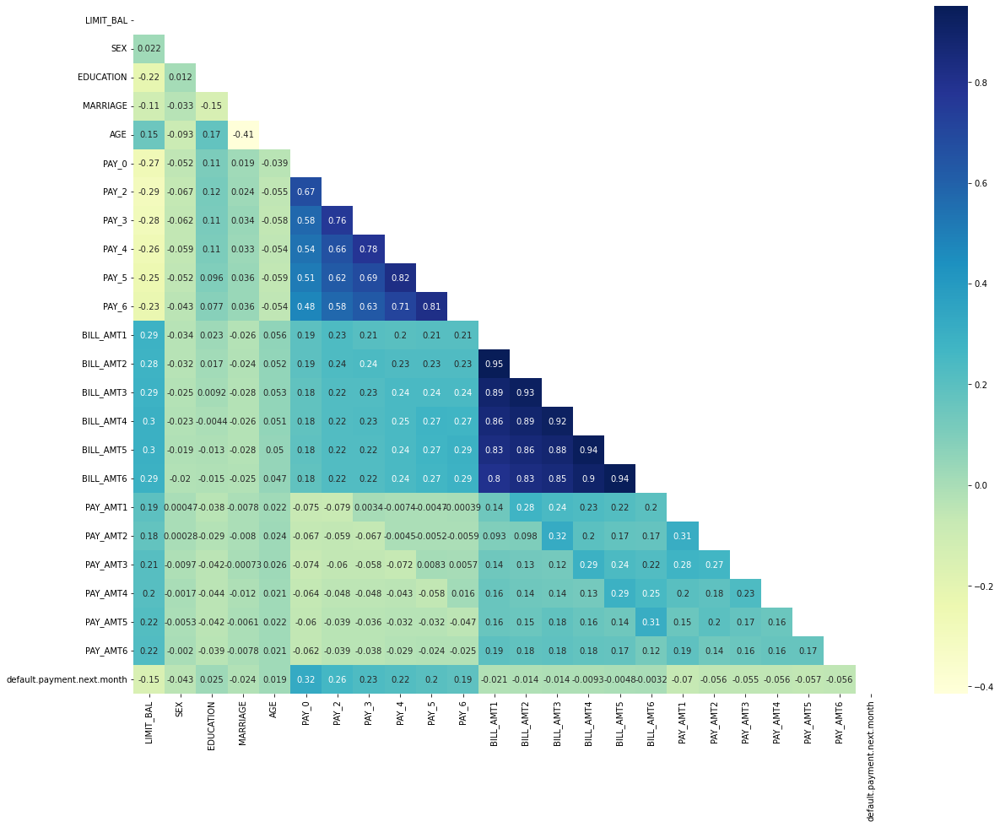

In [8]:
plt.figure(figsize = (20,15))
mask = np.triu(np.ones_like(train.corr()))
 
dataplot = sns.heatmap(train.corr(), cmap="YlGnBu", annot=True, mask=mask)
plt.show()

BILL_AMT1, BILL_AMT2, BILL_AMT3, BILL_AMT4, BILL_AMT5, BILL_AMT6: Queda BILL_AMT1 que corresponde al facturado en el mes más reciente

In [9]:
# Retirar las columnas correlacionadas
train_clean = train.drop(['BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6'], axis=1)
train_clean

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,240000,2,2,2,37,-2,-2,-2,-2,-2,-2,500,0,0,0,0,0,0,0
1,240000,2,3,1,43,0,0,0,0,0,0,61190,2300,2400,2329,2411,2050,2000,0
2,40000,2,1,2,24,0,0,0,0,0,0,28140,5000,8017,7000,4000,5000,5000,1
3,360000,1,1,2,29,-2,-2,-2,-2,-2,-2,3206,2358,3788,3483,1638,2946,16950,0
4,130000,1,1,2,27,0,0,0,0,0,0,32464,1867,1872,1256,1500,1500,1500,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23994,80000,2,2,2,26,1,-2,-2,-2,-2,-2,0,0,0,0,0,0,0,0
23995,50000,2,3,2,28,1,3,3,2,2,2,40527,2500,0,0,3200,2000,1700,0
23996,500000,1,1,2,33,-1,-1,-1,-2,-1,-1,5379,2065,10556,4170,7963,196,7083,0
23997,50000,1,2,2,42,2,2,2,2,-1,0,22591,0,3701,554,10026,421,6106,0


In [10]:
unique_values = pd.DataFrame(columns=['Column'])
for column in train_clean.columns:
    unique_values = unique_values.append({'Column': column, 'Unique count': train_clean[column].nunique(), 'Unique Desc': np.sort(train_clean[column].unique())}, ignore_index=True)

unique_values

C:\Users\facio\AppData\Local\Temp\ipykernel_2952\2066266009.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\facio\AppData\Local\Temp\ipykernel_2952\2066266009.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\facio\AppData\Local\Temp\ipykernel_2952\2066266009.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\facio\AppData\Local\Temp\ipykernel_2952\2066266009.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\facio\AppData\Local\Temp\ipykernel_2952\2066266009.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

,Column,Unique Desc,Unique count
0,LIMIT_BAL,"[10000, 16000, 20000, 30000, 40000, 50000, 600...",80.0
1,SEX,"[1, 2]",2.0
2,EDUCATION,"[0, 1, 2, 3, 4, 5, 6]",7.0
3,MARRIAGE,"[0, 1, 2, 3]",4.0
4,AGE,"[21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 3...",56.0
5,PAY_0,"[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8]",11.0
6,PAY_2,"[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8]",11.0
7,PAY_3,"[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8]",11.0
8,PAY_4,"[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7]",10.0
9,PAY_5,"[-2, -1, 0, 2, 3, 4, 5, 6, 7]",9.0


In [11]:
train_clean.describe()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
count,23999.000000,23999.000000,23999.000000,23999.000000,23999.000000,23999.000000,23999.000000,23999.000000,23999.000000,23999.000000,23999.000000,23999.000000,23999.000000,2.399900e+04,23999.000000,23999.000000,23999.000000,23999.000000,23999.000000
mean,167235.704821,1.603275,1.857536,1.551731,35.490104,-0.015084,-0.129130,-0.160048,-0.217842,-0.266136,-0.291012,51139.428851,5619.139672,5.955432e+03,5232.112588,4899.949081,4819.284804,5183.254552,0.221218
std,129760.562570,0.489228,0.790284,0.521619,9.225534,1.125446,1.198118,1.199533,1.168044,1.132691,1.149931,73530.804672,16704.793309,2.407890e+04,17385.015428,16304.075472,15515.272718,17440.453292,0.415075
min,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-165580.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,3566.500000,1000.000000,8.050000e+02,390.000000,291.000000,241.000000,120.000000,0.000000
50%,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,22335.000000,2100.000000,2.006000e+03,1800.000000,1500.000000,1500.000000,1500.000000,0.000000
75%,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,66862.500000,5001.500000,5.000000e+03,4500.000000,4000.000000,4005.000000,4000.000000,0.000000
max,800000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,7.000000,7.000000,8.000000,746814.000000,873552.000000,1.684259e+06,889043.000000,621000.000000,426529.000000,443001.000000,1.000000


In [12]:
(test['BILL_AMT1']<0).value_counts()[True]

123

In [13]:
# Revisar cuántos registros tienen valor negativo o cero en Bill_AMT1 que es el valor facturado y no debería tener este tipo de valores
(train_clean['BILL_AMT1']<0).value_counts()[True]

467

Education tiene valores 0 los cuales no están contemplados en la descripción inicial
- Reemplazar los 0 por 4 que corresponde a _others_ ❓
- Que hacemos con los que son 5 y 6 que son _unknown_? ❓

Marriage tiene valores 0 los cuales no están contemplados en la descripción inicial
- Reemplazar los 0 por 3 que corresponde a _others_ ❓

PAY_0..6 igual tiene valores 0 que no estaba descrito
- Dado que -1 indica que se ha pagado a tiempo.  deberíamos quitar estos ceros ❓
- Usar una técnica de imputación para que basado en las otras columnas le asignemos un valor acorde ❓

Hay 467 registros con valores negativos en BILL_AMT1
- Está bien que esta columna tenga negativos❓
- Quitamos estas observaciones❓
- Usar una técnica de imputación para que basado en las otras columnas le asignemos un valor acorde ❓

PAY_AMT1..6 también tienen valores cero, para estas columnas si está bien tener un valor 0 cierto❓

## 2. Selección y Extracción de variables

### 2.1 Filtro con RF

In [17]:
mu_inf = mutual_info_regression(XTrain, yTrain, discrete_features=False, n_neighbors=9)
mu_inf_vals = sorted(set(mu_inf), reverse=True)
mu_inf_vals = np.array(mu_inf_vals)

minAuc = 0
clfRF2_selected = None
cols_rf_sel = []

for v in mu_inf_vals:
    cols_rf = XTrain.columns[mu_inf >= v]
    clfRF2 = RandomForestClassifier(random_state=50)
    clfRF2.fit(XTrain[cols_rf], yTrain)

    prediccionesProb=clfRF2.predict_proba(XTest[cols_rf])
    fpr, tpr, thresholds = metrics.roc_curve(yTest, prediccionesProb[:,1], pos_label=1)
    AUC=metrics.auc(fpr, tpr)

    if AUC > minAuc:
        minAuc = AUC
        clfRF2_selected = clfRF2
        cols_rf_sel = cols_rf  

cols_rf_sel

Index(['LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2',
       'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6'],
      dtype='object')

## 3. Preprocesamiento de datos

In [194]:
cols = train.columns[0:-1]
target_col = train.columns[-1]
XTrain, XTest, yTrain, yTest = train_test_split(train[cols], train[target_col], test_size=0.33, random_state=45)
XTrain2 = XTrain
yTrain2 = yTrain 

### 3.0 Balanceo Upsampling

In [195]:
XTrain = XTrain2
yTrain = yTrain2

sm = SMOTE(random_state=45) 

XTrain, yTrain = sm.fit_resample(XTrain, yTrain)

### 3.1 Escalado

In [196]:
scaler = preprocessing.StandardScaler().fit(XTrain)
XScaled = scaler.transform(XTrain)
XTestScaled = scaler.transform(XTest)
testScaled = scaler.transform(test)

## 4. Evaluación de modelos utilizados en la competencia

In [197]:
def show_roc(clf,  X_test = XTest, istf =  False):
    pred = []
    prediccionesProb =  None
    if istf:
        prediccionesProb=clf.predict(X_test)
    else:
        prediccionesProb=clf.predict_proba(X_test)[:,1]
        pred = clf.predict(X_test)

    if len(pred) != 0:
        cm = confusion_matrix(pred, yTest)
        display(cm)

    fpr, tpr, thresholds = metrics.roc_curve(yTest, prediccionesProb, pos_label=1)
    AUC=metrics.auc(fpr, tpr)

    plt.title('Receiver Operating Characteristic')
    plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % AUC)
    plt.legend(loc = 'lower right')
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([-0.01, 1])
    plt.ylim([0, 1.05])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()


def save_predict(model, name, test_data=test, mode=None):
    prob = None
    if mode == 'tf':
        prob = model.predict(test_data)[:,0]
    elif mode == 'pred':
        prob = model.predict(test_data)
    else:
        prob = model.predict_proba(test_data)[:,1]

    to_save = pd.DataFrame({'Id': test.index + 1, 'Probability': prob })
    to_save.to_csv(f'{path}{name}.csv', index=False)

### 4.1 MLP 

In [198]:
clf = MLPClassifier(solver='lbfgs', alpha=1e-5, hidden_layer_sizes=(5, 5, 2), random_state=1,max_iter=5000)
clf.fit(XScaled, yTrain)

MLPClassifier(alpha=1e-05, hidden_layer_sizes=(5, 5, 2), max_iter=5000,
              random_state=1, solver='lbfgs')

c:\Users\facio\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning:

X has feature names, but MLPClassifier was fitted without feature names

c:\Users\facio\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning:

X has feature names, but MLPClassifier was fitted without feature names



array([[4971,  754],
       [1199,  996]], dtype=int64)

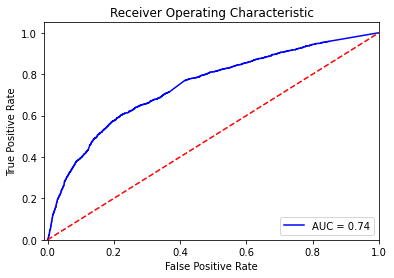

In [199]:
XTestAux = a = pd.DataFrame(XTestScaled, columns=cols)
show_roc(clf, X_test=XTestAux)

In [21]:
valScaled = scaler.transform(test)
save_predict(clf, 'NN', test_data=valScaled)

### 4.2 RFE con 10 variables y RandomForest

In [200]:
selected_features = []
estimator3 = RandomForestRegressor()

selector3 = RFE(estimator3, n_features_to_select=10, step=1)
selector3 = selector3.fit(XTrain, yTrain)
    
selected_feature_index = selector3.support_.tolist().index(True)
selected_feature = XTrain.columns[selected_feature_index]
selected_features.append(selected_feature)

sel_cols = XTrain.columns[selector3.support_]
sel_cols

Index(['LIMIT_BAL', 'AGE', 'PAY_0', 'PAY_2', 'BILL_AMT1', 'BILL_AMT5',
       'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4'],
      dtype='object')

array([[5344,  890],
       [ 826,  860]], dtype=int64)

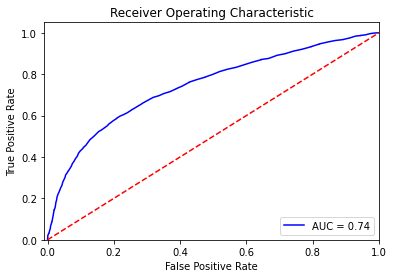

In [202]:
model_rf = RandomForestClassifier()
model_rf.fit(XTrain[sel_cols], yTrain)
show_roc(model_rf, X_test=XTest[sel_cols])

### 4.3 Escalado con super vector machine

#### 4.3.1 Linear

array([[4505,  736],
       [1665, 1014]], dtype=int64)

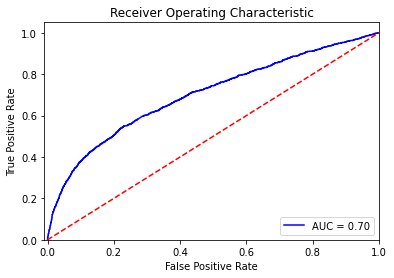

In [203]:
clf_svc_lineal = SVC(kernel='linear', C=1, random_state=42, probability=True)
clf_svc_lineal.fit(XScaled, yTrain)
show_roc(clf_svc_lineal, X_test=XTestScaled)

#### 4.3.2 Poly

array([[6036, 1408],
       [ 134,  342]], dtype=int64)

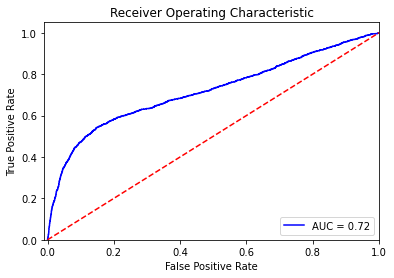

In [160]:
clf_svc_poly = SVC(kernel='poly', C=1, random_state=42, probability=True)
clf_svc_poly.fit(XScaled, yTrain)
show_roc(clf_svc_poly, X_test=XTestScaled)

#### 4.3.3 Radial

array([[5935, 1159],
       [ 235,  591]], dtype=int64)

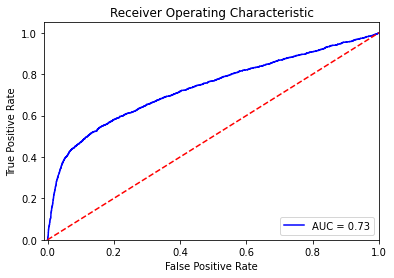

In [161]:
clf_svc_rbf = SVC(kernel='rbf', C=1, random_state=42, probability=True)
clf_svc_rbf.fit(XScaled, yTrain)
show_roc(clf_svc_rbf, X_test=XTestScaled)

### 4.4 XGboost

https://xgboost.readthedocs.io/

#### 4.4.1 XGboost 1 (0.77603) ****

In [204]:
# params = {
#     'learning_rate': [0.01, 0.05, 0.1],
#     'max_depth': [3, 5, 7],
#     'subsample': [0.6, 0.8, 1.0],
#     'colsample_bytree': [0.6, 0.8, 1.0],
#     'n_estimators': [100, 500, 1000]
# }

# model = xgb.XGBRegressor()

# grid_search = GridSearchCV(model, param_grid=params, cv=5, n_jobs=-1, verbose=3)

#  grid_search.fit(XTrain, yTrain)

# best_params = grid_search.best_params_
# print(best_params)

AttributeError: 'GridSearchCV' object has no attribute 'best_params_'

In [183]:
params = {
    'subsample': '0.8',
    'max_depth': 5,
    'learning_rate': 0.01,
    'colsample_bytree': 0.8,
    'n_estimators': 500
}


xgb_model = xgb.XGBClassifier(**params)
lr_model = LogisticRegression()

# Definir el modelo ensamblado utilizando la técnica de Stacking
stacking_model = StackingClassifier(
    estimators=[('xgb', xgb_model), ('lr', lr_model)],
    final_estimator=LogisticRegression()
)

stacking_model.fit(XTrain, yTrain)

StackingClassifier(estimators=[('xgb',
                                XGBClassifier(base_score=None, booster=None,
                                              callbacks=None,
                                              colsample_bylevel=None,
                                              colsample_bynode=None,
                                              colsample_bytree=0.8,
                                              early_stopping_rounds=None,
                                              enable_categorical=False,
                                              eval_metric=None,
                                              feature_types=None, gamma=None,
                                              gpu_id=None, grow_policy=None,
                                              importance_type=None,
                                              interaction_constraints=None,
                                              learning_rate=0.01, max_bin=None,
                          

array([[1382,  687],
       [ 341, 1094]], dtype=int64)

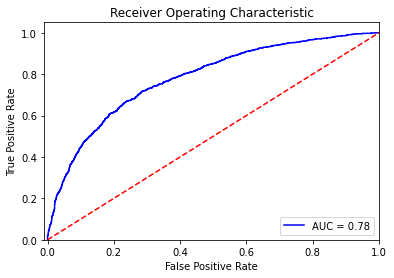

In [189]:
show_roc(stacking_model)

In [190]:
save_predict(stacking_model, 'XGBoost_LR_balancing_down')

c:\Users\facio\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning:

X has feature names, but LogisticRegression was fitted without feature names



#### 4.4.2 XGboost 2 (0.77202)

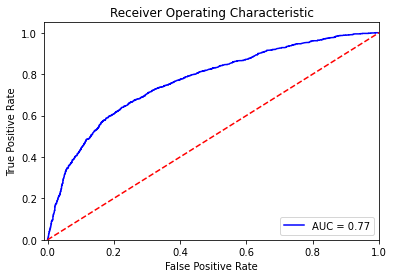

In [181]:
# define los parámetros del modelo
params = {
    'objective': 'reg:squarederror',
    'max_depth': 3,
    'learning_rate': 1,
    'alpha': 5
}

# crea el objeto DMatrix para los datos de entrenamiento y prueba
dtrain = xgb.DMatrix(XTrain, label=yTrain)
dtest = xgb.DMatrix(XTest, label=yTest)

model_xgboost = xgb.train(params, dtrain)
show_roc(model_xgboost, X_test=dtest, istf=True)

In [85]:
dval_test = xgb.DMatrix(test)
save_predict(model_xgboost, 'XGBoost', test_data=dval_test, istf=True)

### 4.3 TF 1 (0.77304)

In [176]:
# Definir el modelo
model_tf1 = keras.Sequential([
    keras.layers.Dense(128, input_shape=(23,), activation='relu'),
    keras.layers.BatchNormalization(),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.BatchNormalization(),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(1, activation='sigmoid')
])

# Compilar el modelo
opt = keras.optimizers.Adam(learning_rate=0.001)
model_tf1.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])

# Ajustar el modelo
history = model_tf1.fit(XScaled, yTrain, epochs=50, batch_size=64, validation_data=(XTestScaled, yTest))



Epoch 1/50
112/112 [==============================] - 2s 5ms/step - loss: 0.7903 - accuracy: 0.6012 - val_loss: 0.6210 - val_accuracy: 0.6664
Epoch 2/50
112/112 [==============================] - 0s 3ms/step - loss: 0.6815 - accuracy: 0.6441 - val_loss: 0.5978 - val_accuracy: 0.6832
Epoch 3/50
112/112 [==============================] - 0s 3ms/step - loss: 0.6523 - accuracy: 0.6538 - val_loss: 0.5934 - val_accuracy: 0.6895
Epoch 4/50
112/112 [==============================] - 0s 3ms/step - loss: 0.6242 - accuracy: 0.6628 - val_loss: 0.5877 - val_accuracy: 0.6949
Epoch 5/50
112/112 [==============================] - 0s 3ms/step - loss: 0.6066 - accuracy: 0.6871 - val_loss: 0.5878 - val_accuracy: 0.6875
Epoch 6/50
112/112 [==============================] - 0s 3ms/step - loss: 0.6044 - accuracy: 0.6815 - val_loss: 0.5870 - val_accuracy: 0.6895
Epoch 7/50
112/112 [==============================] - 0s 3ms/step - loss: 0.5992 - accuracy: 0.6788 - val_loss: 0.5848 - val_accuracy: 0.6909
Epoch 

110/110 [==============================] - 0s 1ms/step


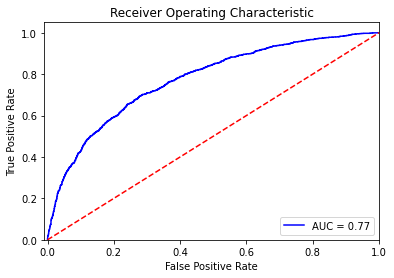

In [177]:
XTestDl = pd.DataFrame(XTestScaled, columns=cols)

show_roc(model_tf1, istf=True, X_test=XTestDl)

In [141]:
save_predict(model_tf1, 'NN_TF_no_scaled', test_data=testScaled, mode='tf')

188/188 [==============================] - 0s 1ms/step


### 4.4 TF 2

Epoch 1/50
503/503 [==============================] - 3s 3ms/step - loss: 0.7137 - accuracy: 0.7357 - val_loss: 0.5605 - val_accuracy: 0.8056
Epoch 2/50
503/503 [==============================] - 1s 2ms/step - loss: 0.5953 - accuracy: 0.7905 - val_loss: 0.5372 - val_accuracy: 0.8117
Epoch 3/50
503/503 [==============================] - 1s 2ms/step - loss: 0.5570 - accuracy: 0.8019 - val_loss: 0.5205 - val_accuracy: 0.8101
Epoch 4/50
503/503 [==============================] - 1s 2ms/step - loss: 0.5347 - accuracy: 0.8041 - val_loss: 0.5054 - val_accuracy: 0.8085
Epoch 5/50
503/503 [==============================] - 1s 2ms/step - loss: 0.5162 - accuracy: 0.8043 - val_loss: 0.4862 - val_accuracy: 0.8143
Epoch 6/50
503/503 [==============================] - 1s 2ms/step - loss: 0.5020 - accuracy: 0.8051 - val_loss: 0.4758 - val_accuracy: 0.8177
Epoch 7/50
503/503 [==============================] - 1s 2ms/step - loss: 0.4926 - accuracy: 0.8053 - val_loss: 0.4665 - val_accuracy: 0.8158
Epoch 

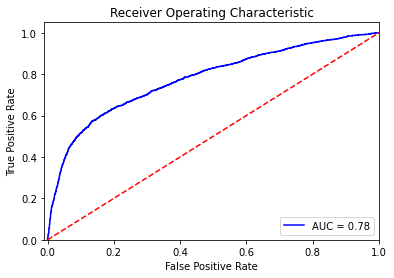

In [26]:
# Definir el modelo
model2 = keras.Sequential([
    keras.layers.Dense(128, input_shape=(23,), activation='swish', kernel_regularizer=keras.regularizers.L2(0.001)),
    keras.layers.BatchNormalization(),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(64, activation='swish', kernel_regularizer=keras.regularizers.L2(0.001)),
    keras.layers.BatchNormalization(),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(1, activation='sigmoid')
])

# Compilar el modelo
opt = keras.optimizers.Adam(learning_rate=0.001)
model2.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])

# Ajustar el modelo
history = model2.fit(XScaled, yTrain, epochs=50, batch_size=32, validation_data=(XTestScaled, yTest))

# Evaluar el modelo
test_loss, test_acc = model2.evaluate(XTestScaled, yTest)
print('Accuracy:', test_acc)

show_roc(model2, istf=True, XTest=XTestDl)


## 5. Selección de modelo final, análisis y conclusiones